## Project - Analysis of FAWSL players for 2018-2021 seasons
### Data Import and Cleaning 
#### Author: Alexandru Mihalache
#### Date: October 2022

- Aim of this notebook is to import, clean and select the data I will be using for this analysis. 
The data is sourced from the Open Data provided by [StatsBomb](https://github.com/statsbomb/open-data). This dataset contains match results, lineups and match events for the league and seasons in scope. The match events dataset is particularly important as it contains a full list of in match events, where an event could be a pass, goal, interception, along with information, on location of events (in the form of X,Y coordinates), players involved and order of events. [See full Data Dictionary here](https://github.com/statsbomb/open-data/blob/master/doc/Open%20Data%20Events%20v4.0.0.pdf)

- For this analysis we will also use the  [MPL soccer library of functions](https://mplsoccer.readthedocs.io/en/latest/gallery/statsbomb/plot_statsbomb_data.html#) - this will allow me to pull in data from StatsBomb as well as provide a pitch visualisations based on Matplotlib, which allow us to visualise different events on the pitch. 

- Will also use some of the methods in the [SoccerMatics](https://soccermatics.readthedocs.io/en/latest/gallery/plot_UsingStatsbomb.html) course to calculate footbal metrics such as xG (Expected Goals), xT (Threat) and other KPIs which will then be fed into the model in scope for this project. 

Contents: 

1. Load data competition data
2. Load events for competition
3. Add in Season ID to events table
4. Add in match score
5. Extract win/draw/loss statistics by team 
6. Save event data as CSV



In [2]:
#Importing SBopen class from mplsoccer to access StatsBomb data
from mplsoccer import Pitch, Sbopen, VerticalPitch
# To parse the JSON files StatsBomb provides, will use the parser included in mplsoccer.
parser = Sbopen()

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import requests

### Extracting data from StatsBomb

This will be a multi-step process to identify the right IDs and then retrieve the data using the mplsoccer library, which will also help parse and format the JSON files into dataframes.

To find out which season IDs and competition IDs I need to use, will retrieve the competion table. 

In [3]:
#opening data using competition method
df_competition = parser.competition()

Will get an overview of the columns in this dataset, to find out what I need to look for to isolate the FAWSL data. 

In [4]:
df_competition.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42 entries, 0 to 41
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype 
---  ------                     --------------  ----- 
 0   competition_id             42 non-null     int64 
 1   season_id                  42 non-null     int64 
 2   country_name               42 non-null     object
 3   competition_name           42 non-null     object
 4   competition_gender         42 non-null     object
 5   competition_youth          42 non-null     bool  
 6   competition_international  42 non-null     bool  
 7   season_name                42 non-null     object
 8   match_updated              42 non-null     object
 9   match_updated_360          41 non-null     object
 10  match_available_360        3 non-null      object
 11  match_available            42 non-null     object
dtypes: bool(2), int64(2), object(8)
memory usage: 3.5+ KB


Based on on this, will look at getting the competion name values to filter the dataset. 

In [5]:
df_competition['competition_name'].unique()

array(['Champions League', "FA Women's Super League", 'FIFA World Cup',
       'Indian Super league', 'La Liga', 'NWSL', 'Premier League',
       'UEFA Euro', "UEFA Women's Euro", "Women's World Cup"],
      dtype=object)

Filtering for the competion I am interesting 

In [6]:
df_competition[df_competition.competition_name =="FA Women's Super League"]

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
15,37,90,England,FA Women's Super League,female,False,False,2020/2021,2022-08-16T02:10:37.220648,2021-06-13T16:17:31.694,None,2022-08-16T02:10:37.220648
16,37,42,England,FA Women's Super League,female,False,False,2019/2020,2021-06-01T13:01:18.188,2021-06-13T16:17:31.694,None,2021-06-01T13:01:18.188
17,37,4,England,FA Women's Super League,female,False,False,2018/2019,2022-09-12T21:06:25.061309,2021-06-13T16:17:31.694,None,2022-09-12T21:06:25.061309


Save all the season IDs to use in retrieving the event data. 

In [7]:
season = df_competition.loc[df_competition['competition_id'] == 37, ['season_id']]
season

,season_id
15,90
16,42
17,4


For each season I am getting all the match IDs I need event data from. 

In [8]:
seasons_matches = [parser.match(competition_id=37, season_id=int(x[1]))['match_id'] for x in season.iterrows()]

Requesting event data for all matches in scope.

In [11]:
all_events_list = []
for i in range(len(seasons_matches)):
    for y in seasons_matches[i]: 
        events = parser.event(y)[0]
        all_events_list.append(events)   

all_events = pd.concat(all_events_list, ignore_index=True)

In [14]:
#We're working with a large dataset and may need to view columns
pd.set_option("display.max_rows", None, "display.max_columns", None)

In [16]:
all_events.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1095974 entries, 0 to 1095973
Data columns (total 90 columns):
 #   Column                          Non-Null Count    Dtype  
---  ------                          --------------    -----  
 0   id                              1095974 non-null  object 
 1   index                           1095974 non-null  int64  
 2   period                          1095974 non-null  int64  
 3   timestamp                       1095974 non-null  object 
 4   minute                          1095974 non-null  int64  
 5   second                          1095974 non-null  int64  
 6   possession                      1095974 non-null  int64  
 7   duration                        822374 non-null   float64
 8   match_id                        1095974 non-null  int64  
 9   type_id                         1095974 non-null  int64  
 10  type_name                       1095974 non-null  object 
 11  possession_team_id              1095974 non-null  int64  
 12  

In [79]:
all_events.describe().T

,count,mean,std,min,25%,50%,75%,max
index,1095974.0,1.699346e+03,1.000506e+03,1.000000,841.000000,1.681000e+03,2.524000e+03,4.383000e+03
period,1095974.0,1.491000e+00,4.999192e-01,1.000000,1.000000,1.000000e+00,2.000000e+00,2.000000e+00
minute,1095974.0,4.510227e+01,2.709818e+01,0.000000,22.000000,4.500000e+01,6.800000e+01,1.020000e+02
second,1095974.0,2.928383e+01,1.739878e+01,0.000000,14.000000,2.900000e+01,4.400000e+01,5.900000e+01
possession,1095974.0,1.006055e+02,5.912934e+01,1.000000,50.000000,9.900000e+01,1.490000e+02,2.550000e+02
duration,822374.0,1.271205e+00,1.408107e+00,0.000000,0.195237,1.059261e+00,1.779212e+00,1.586592e+02
match_id,1095974.0,2.139909e+06,1.601260e+06,7298.000000,19796.000000,2.275105e+06,3.775577e+06,3.775659e+06
type_id,1095974.0,3.173717e+01,1.257325e+01,2.000000,30.000000,3.000000e+01,4.200000e+01,4.300000e+01
possession_team_id,1095974.0,1.005265e+03,3.113034e+02,746.000000,966.000000,9.690000e+02,9.720000e+02,2.647000e+03
play_pattern_id,1095974.0,2.985538e+00,2.237178e+00,1.000000,1.000000,3.000000e+00,4.000000e+00,9.000000e+00


In [22]:
all_events.head()

,id,index,period,timestamp,minute,second,possession,duration,match_id,type_id,type_name,possession_team_id,possession_team_name,play_pattern_id,play_pattern_name,team_id,team_name,tactics_formation,player_id,player_name,position_id,position_name,pass_recipient_id,pass_recipient_name,pass_length,pass_angle,pass_height_id,pass_height_name,end_x,end_y,sub_type_id,sub_type_name,body_part_id,body_part_name,x,y,under_pressure,outcome_id,outcome_name,counterpress,pass_cross,aerial_won,pass_assisted_shot_id,pass_shot_assist,shot_statsbomb_xg,shot_key_pass_id,technique_id,technique_name,goalkeeper_position_id,goalkeeper_position_name,out,off_camera,pass_switch,pass_cut_back,ball_recovery_recovery_failure,foul_won_defensive,pass_deflected,end_z,foul_committed_advantage,foul_won_advantage,shot_first_time,block_offensive,pass_no_touch,pass_miscommunication,pass_goal_assist,substitution_replacement_id,substitution_replacement_name,block_deflection,dribble_nutmeg,shot_one_on_one,shot_open_goal,foul_committed_card_id,foul_committed_card_name,injury_stoppage_in_chain,dribble_overrun,shot_deflected,foul_committed_penalty,foul_won_penalty,shot_redirect,foul_committed_offensive,ball_recovery_offensive,block_save_block,bad_behaviour_card_id,bad_behaviour_card_name,dribble_no_touch,shot_follows_dribble,half_start_late_video_start,half_end_early_video_end,pass_backheel,player_off_permanent,season_id
0,3ae5d153-60b6-4fb0-a4c3-7406eb19134b,1,1,00:00:00,0,0,1,0.000000,3775648,35,Starting XI,2647,Aston Villa,1,Regular Play,2647,Aston Villa,352.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90
1,dd387270-fb96-4574-aba5-4817cd6de379,2,1,00:00:00,0,0,1,0.000000,3775648,35,Starting XI,2647,Aston Villa,1,Regular Play,968,Arsenal WFC,433.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90
2,1cae007e-b10b-4959-be1f-5b595313b72c,3,1,00:00:00,0,0,1,0.000000,3775648,18,Half Start,2647,Aston Villa,1,Regular Play,968,Arsenal WFC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90
3,02403d23-9d60-4754-a1d7-7143ce0cffd7,4,1,00:00:00,0,0,1,0.000000,3775648,18,Half Start,2647,Aston Villa,1,Regular Play,2647,Aston Villa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90
4,d062f895-1e3c-4fff-9937-fa3c81408bf7,5,1,00:00:00.340000,0,0,2,0.311672,3775648,30,Pass,968,Arsenal WFC,9,From Kick Off,968,Arsenal WFC,NaN,15623.0,Vivianne Miedema,21.0,Left Wing,15619.0,Bethany Mead,2.416609,1.144169,1.0,Ground Pass,62.0,42.3,65.0,Kick Off,40.0,Right Foot,61.0,40.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,90


This is a large dataset with 89 columns, most of the columns will have substantial ammounts of null values, as they are only filled when certain events occur during a match, to describe that event. 

It may be useful to fill the nulls in with a dummy variable, however as the filled values are different categories, there is a risk of generating a large amount of columns. 

In [18]:
all_events['season_id'] = all_events['match_id'].apply(lambda x: 90 if str(x)[0] == '3' else (42 if str(x)[0] == '2' else 4)  )

Looking at the wins/draws/losses, for 2020-2021 Season. As we have a lot of matches, will dive a little deeper into the most recent season to discover if there are any data features I should look at. 

In [32]:
season_90 = parser.match(competition_id=37, season_id=90)
season_90_team_names = season_90['home_team_name'].unique()

season_90_outcome_table = {}
team_name = ''
wins = 0
draws = 0
losses = 0

for team in season_90_team_names:
    for index, row in season_90.iterrows():
        if ((row['home_team_name'] ==  team) 
            & (row['home_score'] > row['away_score'])
            | (row['away_team_name'] ==  team) 
            & (row['home_score'] < row['away_score'])
            ):
            wins += 1
        if (((row['home_team_name'] ==  team) 
            | (row['away_team_name'] ==  team))
            & (row['home_score'] == row['away_score'])):
            draws += 1
        if ((row['home_team_name'] ==  team) 
            & (row['home_score'] < row['away_score'])
            | (row['away_team_name'] ==  team) 
            & (row['home_score'] > row['away_score'])
        ):
            losses +=1
    season_90_outcome_table.update({team:{'wins': wins, 'draws': draws, 'losses': losses }})
    wins = 0
    draws = 0
    losses = 0

print(season_90_outcome_table)
        

{'Aston Villa': {'wins': 3, 'draws': 6, 'losses': 13}, 'Arsenal WFC': {'wins': 15, 'draws': 3, 'losses': 4}, 'Brighton & Hove Albion WFC': {'wins': 8, 'draws': 3, 'losses': 11}, 'Chelsea FCW': {'wins': 18, 'draws': 3, 'losses': 1}, 'Reading WFC': {'wins': 5, 'draws': 9, 'losses': 8}, 'Manchester United': {'wins': 15, 'draws': 2, 'losses': 5}, 'Birmingham City WFC': {'wins': 3, 'draws': 6, 'losses': 12}, 'Bristol City WFC': {'wins': 2, 'draws': 6, 'losses': 14}, 'West Ham United LFC': {'wins': 3, 'draws': 6, 'losses': 13}, 'Everton LFC': {'wins': 9, 'draws': 5, 'losses': 8}, 'Tottenham Hotspur Women': {'wins': 4, 'draws': 5, 'losses': 12}, 'Manchester City WFC': {'wins': 17, 'draws': 4, 'losses': 1}}


In [33]:
season_90_outcome_table = pd.DataFrame(season_90_outcome_table)
season_90_outcome_table = season_90_outcome_table.T
season_90_outcome_table

,wins,draws,losses
Aston Villa,3,6,13
Arsenal WFC,15,3,4
Brighton & Hove Albion WFC,8,3,11
Chelsea FCW,18,3,1
Reading WFC,5,9,8
Manchester United,15,2,5
Birmingham City WFC,3,6,12
Bristol City WFC,2,6,14
West Ham United LFC,3,6,13
Everton LFC,9,5,8


In [99]:
all_events['under_pressure'].unique()

array([nan,  1.])

In [102]:
spurs_passes_counts = pd.DataFrame()
spurs_passes_counts['under_pressure'] = all_events.loc[(all_events['team_name'] == 'Tottenham Hotspur Women') & (all_events['type_name'] == 'Pass') & (all_events['pass_angle'] > 0) & (all_events['under_pressure'] == 1), ['player_name']].groupby('player_name').value_counts()
spurs_passes_counts['total_pasess'] = all_events.loc[(all_events['team_name'] == 'Tottenham Hotspur Women') & (all_events['type_name'] == 'Pass'), ['player_name']].groupby('player_name').value_counts()

In [107]:
spurs_passes_counts.reset_index(inplace=True)

In [108]:
spurs_passes_counts['forward_pressure'] = (spurs_passes_counts['under_pressure']/spurs_passes_counts['total_pasess'])*100

In [111]:
spurs_passes_counts.sort_values(by='forward_pressure', ascending=False)

,player_name,under_pressure,total_pasess,forward_pressure
2,Alexandra Morgan Carrasco,16,68,23.529412
21,Megan Wynne,2,9,22.222222
8,Coral-Jade Haines,7,36,19.444444
26,Rianna Dean,70,403,17.369727
9,Elish Sulola,1,6,16.666667
12,Gemma Suzanne Davison,86,559,15.384615
23,Rachel Williams,24,157,15.286624
10,Emma Mitchell,23,155,14.838710
22,Rachel Furness,41,287,14.285714
3,Angela Addison,46,352,13.068182


In [77]:
all_related_events_list = []
for i in range(len(seasons_matches)):
    for y in seasons_matches[i]: 
        related = parser.event(y)[1]
        all_related_events_list.append(related)
        
all_related_events = pd.concat(all_related_events_list, ignore_index=True)

In [78]:
all_related_events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2109808 entries, 0 to 2109807
Data columns (total 7 columns):
 #   Column             Dtype 
---  ------             ----- 
 0   match_id           int64 
 1   id                 object
 2   index              int64 
 3   type_name          object
 4   id_related         object
 5   index_related      int64 
 6   type_name_related  object
dtypes: int64(3), object(4)
memory usage: 112.7+ MB


## Taking a subset of games for analysis

In [80]:
df_match = parser.match(competition_id=37, season_id=90)
#our team
team = "Tottenham Hotspur Women"
#get list of games by our team, either home or away
match_ids = df_match.loc[(df_match["home_team_name"] == team) | (df_match["away_team_name"] == team)]["match_id"].tolist()
#calculate number of games
no_games = len(match_ids)

In [81]:
danger_passes = pd.DataFrame()
for idx in match_ids:
    #open the event data from this game
    df = parser.event(idx)[0]
    for period in [1, 2]:
        #keep only accurate passes by Tottenham that were not set pieces in this period
        mask_pass = (df.team_name == team) & (df.type_name == "Pass") & (df.outcome_name.isnull()) & (df.period == period) & (df.sub_type_name.isnull())
        #keep only necessary columns
        passes = df.loc[mask_pass, ["x", "y", "end_x", "end_y", "minute", "second", "player_name"]]
        #keep only Shots by Tottenham in this period
        mask_shot = (df.team_name == team) & (df.type_name == "Shot") & (df.period == period)
        #keep only necessary columns
        shots = df.loc[mask_shot, ["minute", "second"]]
        #convert time to seconds
        shot_times = shots['minute']*60+shots['second']
        shot_window = 15
        #find starts of the window
        shot_start = shot_times - shot_window
        #condition to avoid negative shot starts
        shot_start = shot_start.apply(lambda i: i if i>0 else (period-1)*45)
        #convert to seconds
        pass_times = passes['minute']*60+passes['second']
        #check if pass is in any of the windows for this half
        pass_to_shot = pass_times.apply(lambda x: True in ((shot_start < x) & (x < shot_times)).unique())

        #keep only danger passes
        danger_passes_period = passes.loc[pass_to_shot]
        #concatenate dataframe with a previous one to keep danger passes from the whole tournament
        danger_passes = pd.concat([danger_passes, danger_passes_period])

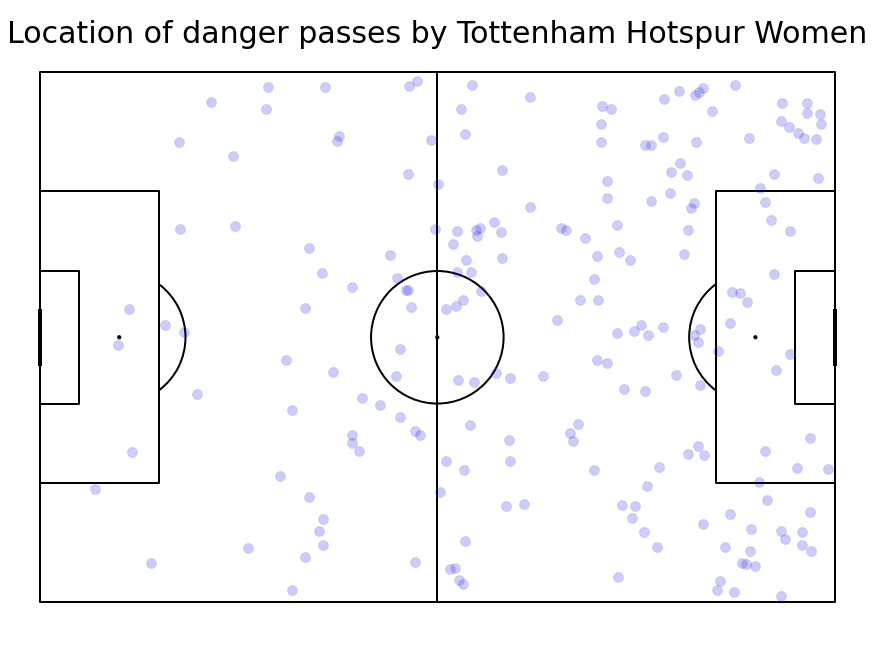

In [90]:
#plot pitch
pitch = Pitch(line_color='black')
fig, ax = pitch.grid(grid_height=0.9, title_height=0.06, axis=False,
                     endnote_height=0.04, title_space=0, endnote_space=0)
#scatter the location on the pitch
pitch.scatter(danger_passes.x, danger_passes.y, s=100, color='blue', edgecolors='grey', linewidth=1, alpha=0.2, ax=ax["pitch"])
#uncomment it to plot arrows
#pitch.arrows(danger_passes.x, danger_passes.y, danger_passes.end_x, danger_passes.end_y, color = "blue", ax=ax['pitch'])
#add title
fig.suptitle('Location of danger passes by ' + team, fontsize = 30)
plt.show()

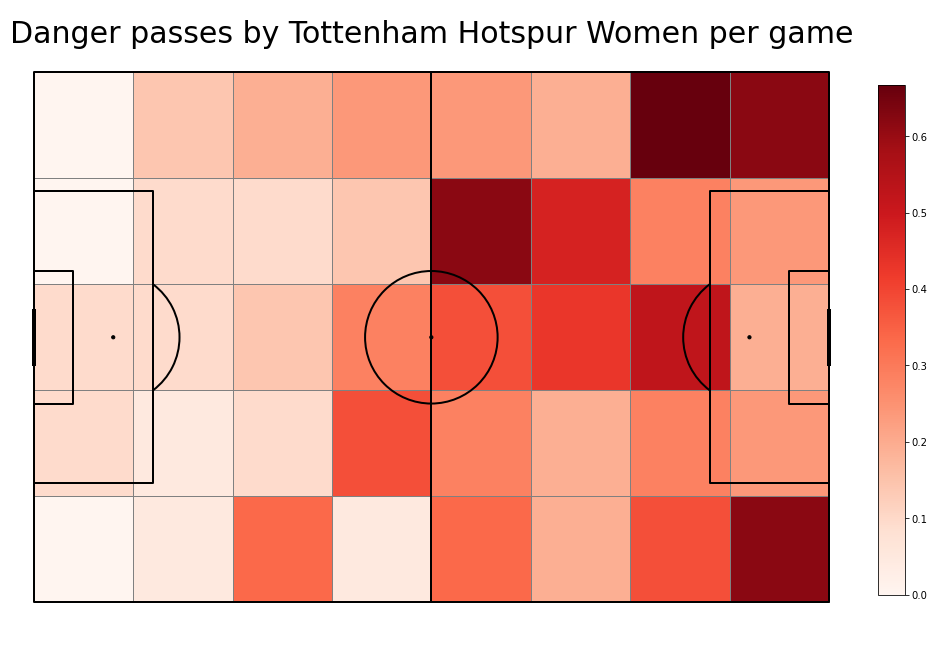

In [98]:
#plot vertical pitch
pitch = Pitch(line_zorder=2, line_color='black')
fig, ax = pitch.grid(grid_height=0.9, title_height=0.06, axis=False,
                     endnote_height=0.04, title_space=0, endnote_space=0)
#get the 2D histogram
bin_statistic = pitch.bin_statistic(danger_passes.x, danger_passes.y, statistic='count', bins=(8, 5), normalize=False)
#normalize by number of games
bin_statistic["statistic"] = bin_statistic["statistic"]/no_games
#make a heatmap
pcm  = pitch.heatmap(bin_statistic, cmap='Reds', edgecolor='grey', ax=ax['pitch'])
#legend to our plot
ax_cbar = fig.add_axes((1, 0.093, 0.03, 0.786))
cbar = plt.colorbar(pcm, cax=ax_cbar)
fig.suptitle('Danger passes by ' + team + " per game", fontsize = 30)
plt.show()

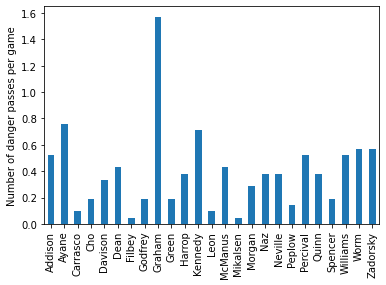

In [92]:
#keep only surnames
danger_passes["player_name"] = danger_passes["player_name"].apply(lambda x: str(x).split()[-1])
#count passes by player and normalize them
pass_count = danger_passes.groupby(["player_name"]).x.count()/no_games
#make a histogram
ax = pass_count.plot.bar(pass_count)
#make legend
ax.set_xlabel("")
ax.set_ylabel("Number of danger passes per game")
plt.show()

----

### Graphs 

----


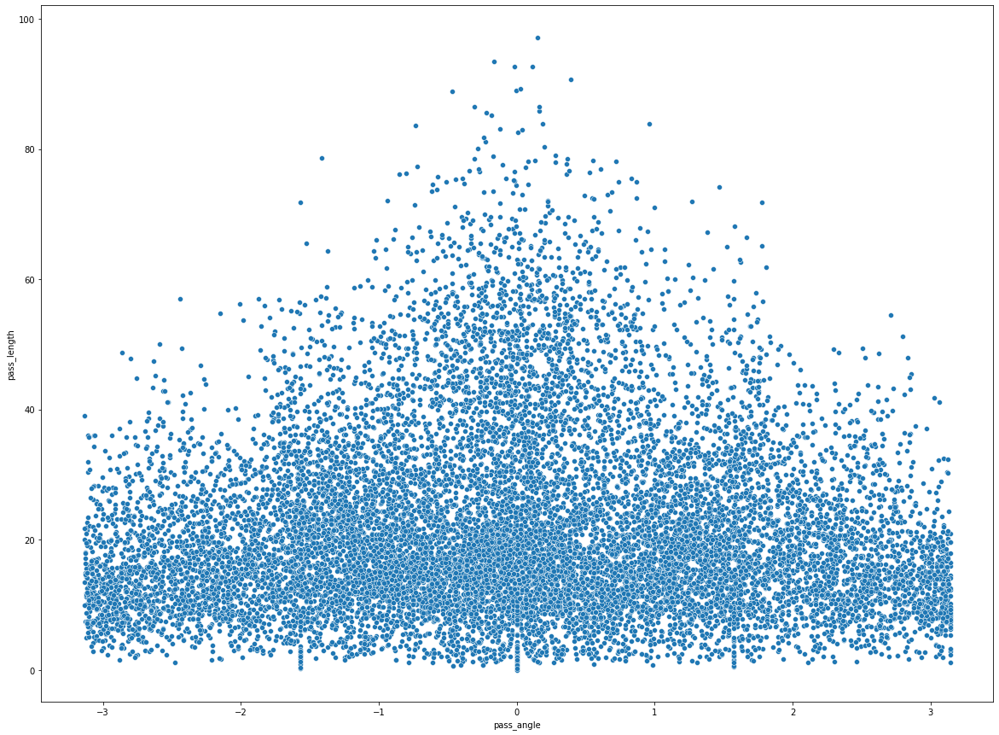

In [37]:
plt.figure(figsize=(20,15))
sns.scatterplot(data=all_events[all_events['team_name']=='Tottenham Hotspur Women'], y='pass_length', x='pass_angle')
plt.show()

In [38]:
import plotly.express as px

In [40]:
fig = px.density_heatmap(all_events, x='pass_angle', y='pass_length')
fig.show()

In [73]:
all_events[all_events.team_name == "Tottenham Hotspur Women"]['sub_type_name'].unique()

array([nan, 'Free Kick', 'Throw-in', 'Recovery', 'Tackle', 'Aerial Lost',
       'Goal Kick', 'Open Play', 'Interception', 'Goal Conceded',
       'Kick Off', 'Shot Faced', 'Corner', 'Shot Saved',
       'Shot Saved Off Target', 'Penalty Conceded', 'Punch', 'Collected',
       'Keeper Sweeper', 'Handball', 'Shot Saved to Post', 'Foul Out',
       'Dangerous Play', 'Penalty'], dtype=object)

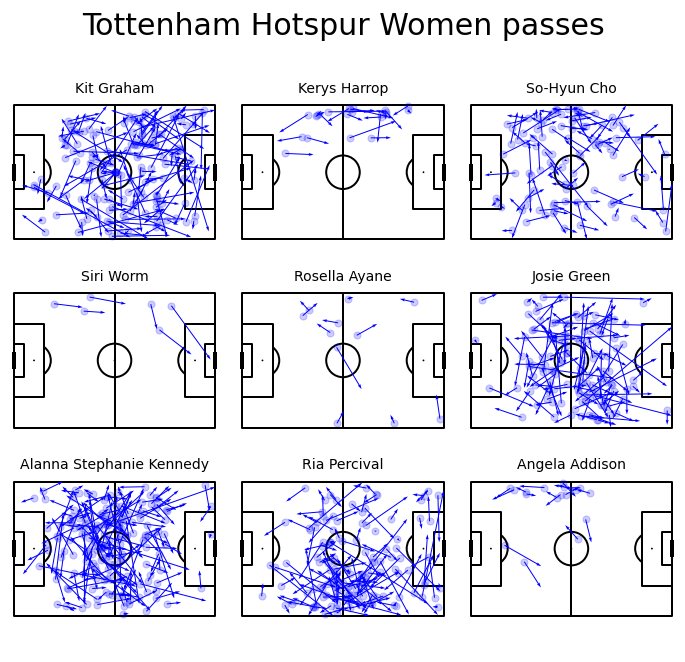

In [76]:
#prepare the dataframe of passes by England that were no-throw ins
from turtle import position

sub_types = ['Corner', 'Throw-in']
midfield_positions = ['Left Center Midfield', 'Center Defensive Midfield','Right Center Midfield']
mask_spurs_pass = (all_events.season_id == 90)&(all_events.type_name == 'Pass')&(all_events.team_name == "Tottenham Hotspur Women")&(~all_events.sub_type_name.isin(sub_types))&(all_events.position_name.isin(midfield_positions))
df_passes = all_events.loc[mask_spurs_pass, ['x', 'y', 'end_x', 'end_y', 'player_name','position_name']]
#get the list of all players who made a pass
names = df_passes['player_name'].unique()


#draw 4x4 pitches
pitch = Pitch(line_color='black', pad_top=20)
fig, axs = pitch.grid(ncols = 3, nrows = 3, grid_height=0.85, title_height=0.06, axis=False,
                     endnote_height=0.04, title_space=0.04, endnote_space=0.01)

#for each player
for name, ax in zip(names, axs['pitch'].flat[:len(names)]):
    #put player name over the plot
    ax.text(60, -10, name,
            ha='center', va='center', fontsize=14)
    #take only passes by this player
    player_df = df_passes.loc[df_passes["player_name"] == name]
    #scatter
    pitch.scatter(player_df.x, player_df.y, alpha = 0.2, s = 50, color = "blue", ax=ax)
    #plot arrow
    pitch.arrows(player_df.x, player_df.y,
            player_df.end_x, player_df.end_y, color = "blue", ax=ax, width=1)
    
#We have more than enough pitches - remove them
for ax in axs['pitch'][-1, 16 - len(names):]:
    ax.remove()
    
#Another way to set title using mplsoccer 
axs['title'].text(0.5, 0.5, 'Tottenham Hotspur Women passes', ha='center', va='center', fontsize=30)
plt.show()

---

# Calculating position based xT

----
Reference:
1. https://karun.in/blog/expected-threat.html
2. https://soccermatics.readthedocs.io/en/latest/gallery/lesson4/plot_ExpectedThreat.html


In [ ]:
next_event = all_events.shift(-1, fill_value=0)
all_events["nextEvent"] = next_event["subEventName"]

df["kickedOut"] = df.apply(lambda x: 1 if x.nextEvent == "Ball out of the field" else 0, axis = 1)
#get move_df
move_df = df.loc[df['subEventName'].isin(['Simple pass', 'High pass', 'Head pass', 'Smart pass', 'Cross'])]
#filtering out of the field
delete_passes = move_df.loc[move_df["kickedOut"] == 1]
move_df = move_df.drop(delete_passes.index)

#extract coordinates
move_df["x"] = move_df.positions.apply(lambda cell: (cell[0]['x']) * 105/100)
move_df["y"] = move_df.positions.apply(lambda cell: (100 - cell[0]['y']) * 68/100)
move_df["end_x"] = move_df.positions.apply(lambda cell: (cell[1]['x']) * 105/100)
move_df["end_y"] = move_df.positions.apply(lambda cell: (100 - cell[1]['y']) * 68/100)

#create 2D histogram of these
pitch = Pitch(line_color='black',pitch_type='custom', pitch_length=105, pitch_width=68, line_zorder = 2)
move = pitch.bin_statistic(move_df.x, move_df.y, statistic='count', bins=(16, 12), normalize=False)

fig, ax = pitch.grid(grid_height=0.9, title_height=0.06, axis=False,
                     endnote_height=0.04, title_space=0, endnote_space=0)
pcm  = pitch.heatmap(move, cmap='Blues', edgecolor='grey', ax=ax['pitch'])
#legend to our plot
ax_cbar = fig.add_axes((1, 0.093, 0.03, 0.786))
cbar = plt.colorbar(pcm, cax=ax_cbar)
fig.suptitle('Moving actions 2D histogram', fontsize = 30)
plt.show()
#get the array
move_count = move["statistic"]